In [ ]:
import os, datetime
from os import path
import numpy as np
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

import tensorflow as tf

# Import datasets, classifiers and performance metrics
from sklearn import datasets, svm, metrics
from sklearn.model_selection import train_test_split, GridSearchCV

# Keras
from keras.models import Sequential 
from keras.layers import Conv2D, MaxPooling2D, AveragePooling2D
from keras.layers import Dense, Dropout 
from keras.layers import Flatten, BatchNormalization
from keras.callbacks import EarlyStopping
from keras.losses import BinaryCrossentropy
from keras.metrics import BinaryAccuracy
from keras.preprocessing.image import ImageDataGenerator

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

# Подключение диска с данными

In [ ]:
drive_mount_dir = '/gdrive'
root_dir = '/gdrive/My Drive/diploma'
data_dir = 'raw_data'
data_root = path.join(root_dir, data_dir)

In [ ]:
from google.colab import drive
drive.mount(drive_mount_dir)

Mounted at /gdrive


# Кодирование меток

Т.к. у нас бинарная классификация, то будет использовать следуюшие значения для классов:
 - листва (камуфляжная или настоящая) - 1
 - все остальное - 0

In [ ]:
labels_map = {
    'other': 0.,
    'foliage': 1.
}

In [ ]:
TILE_SIZE = 4

# Загрузка данных

## Color

In [ ]:
X_c = np.load(path.join(root_dir, 'tiles_data_foliage_other', 'data_color_{}.npy'.format(TILE_SIZE)))
Y_c = np.load(path.join(root_dir, 'tiles_data_foliage_other', 'labels_color_{}.npy'.format(TILE_SIZE)))

In [ ]:
X_c.shape

(141660, 4, 4, 3)

In [ ]:
Y_c_encoded = np.array([labels_map[l] for l in Y_c])

## Multispectral

In [ ]:
waves_multi = ['470', '540', '635', '735', '880']

X_m = []
Y_m = np.load(path.join(root_dir, 'tiles_data_foliage_other', 'labels_multi_{}_{}.npy'.format(waves_multi[0], TILE_SIZE)))

for wave_len in waves_multi:
  data_multi = np.load(path.join(root_dir, 'tiles_data_foliage_other', 'data_multi_{}_{}.npy'.format(wave_len, TILE_SIZE)))

  X_m.append(data_multi[:,:,:,0])

X_m = np.stack(X_m, axis=-1)

In [ ]:
X_m.shape

(124905, 4, 4, 5)

In [ ]:
Y_m_encoded = np.array([labels_map[l] for l in Y_m])

# Перемешивание и разделение выборки

## Color

In [ ]:
X_c_train, X_c_test, y_c_train, y_c_test = train_test_split(X_c, Y_c_encoded, test_size=0.2, shuffle=True, random_state=42)

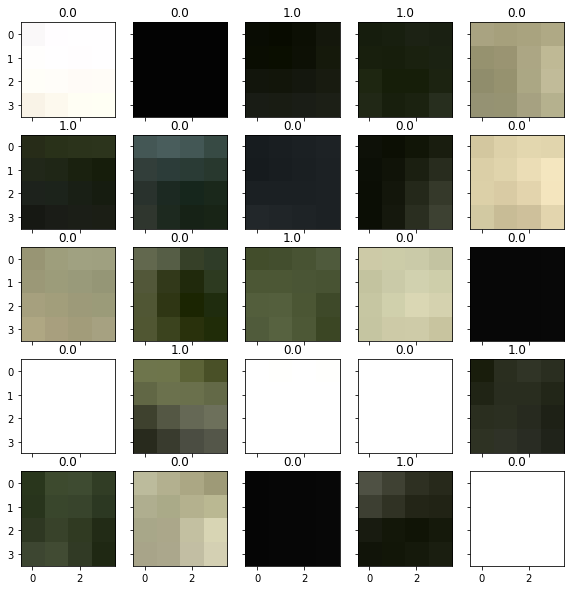

In [ ]:
fig = plt.figure(figsize=(10, 10))
grid = ImageGrid(fig, 111, nrows_ncols=(5, 5), axes_pad=0.25)

start_idx = 300
img_num = 25

for ax, im, label in zip(grid, X_c_train[start_idx:start_idx + img_num], y_c_train[start_idx:start_idx + img_num]):
    # Iterating over the grid returns the Axes.
    ax.imshow(im)
    ax.set_title(label)

plt.show()

## Multispectral

In [ ]:
X_m_train, X_m_test, y_m_train, y_m_test = train_test_split(X_m, Y_m_encoded, test_size=0.2, shuffle=True, random_state=42)

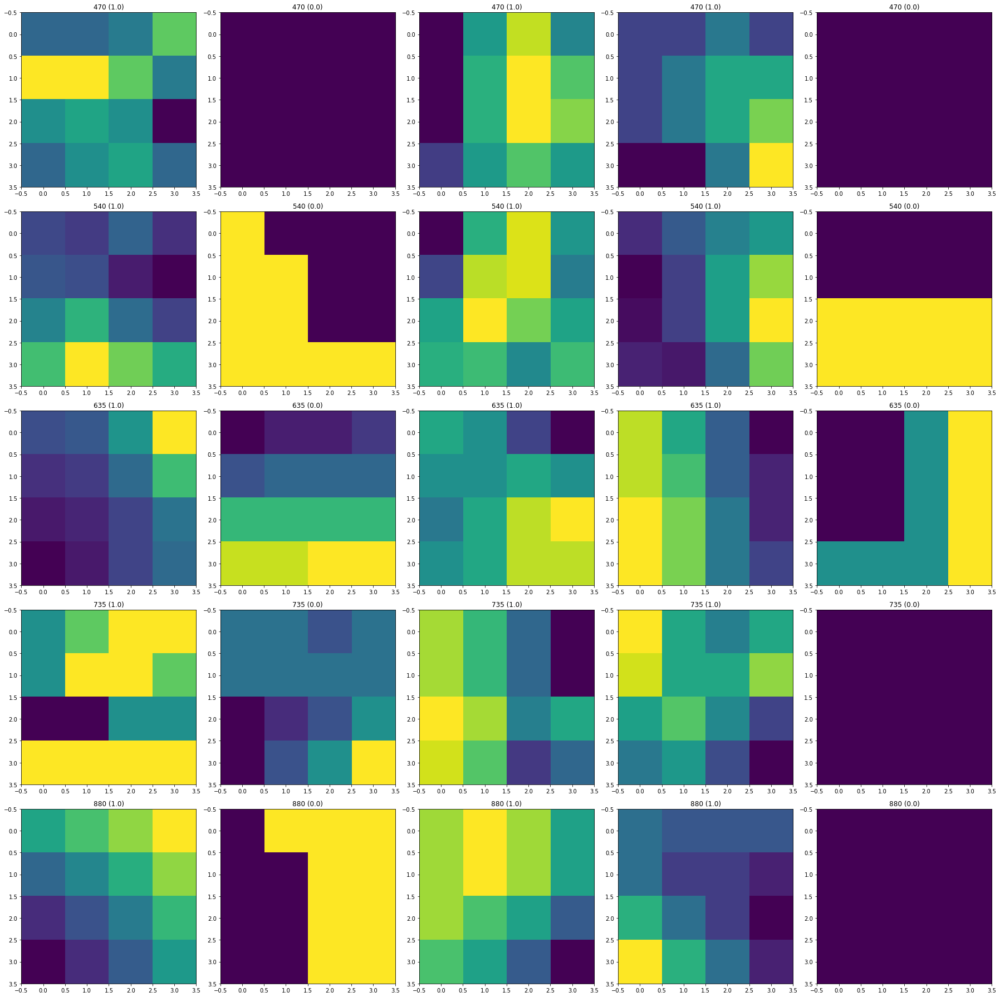

In [ ]:
fig = plt.figure(figsize=(25, 25), tight_layout=True)

ax = fig.subplots(5, 5)

start_idx = 0
img_num = 5

for img_idx in range(start_idx, start_idx + img_num):
  for wave_len in range(len(waves_multi)):
    ax[wave_len, img_idx].imshow(X_m_train[img_idx,:,:,wave_len])
    ax[wave_len, img_idx].set_title('{} ({})'.format(waves_multi[wave_len], y_m_train[img_idx]))

plt.show()

#Catboost


In [ ]:
!pip install catboost

     |████████████████████████████████| 67.3MB 44kB/s 


## Color

In [ ]:
catboost_train_data_c = X_c_train.reshape((X_c_train.shape[0], -1))
catboost_test_data_c = X_c_test.reshape((X_c_test.shape[0], -1))

In [ ]:
catboost_train_data_c[0]

array([0.5568628 , 0.5803922 , 0.47058824, 0.47843137, 0.5137255 ,
       0.40784314, 0.39607844, 0.43529412, 0.3372549 , 0.44705883,
       0.48235294, 0.4       , 0.48235294, 0.5019608 , 0.4117647 ,
       0.40784314, 0.4392157 , 0.34509805, 0.3764706 , 0.41568628,
       0.32156864, 0.4627451 , 0.49803922, 0.41568628, 0.47058824,
       0.49019608, 0.40392157, 0.40392157, 0.43529412, 0.34509805,
       0.39215687, 0.43137255, 0.3372549 , 0.41960785, 0.45490196,
       0.37254903, 0.50980395, 0.5294118 , 0.4509804 , 0.44705883,
       0.47843137, 0.3882353 , 0.4117647 , 0.4509804 , 0.35686275,
       0.3529412 , 0.3882353 , 0.30588236], dtype=float32)

In [ ]:
from catboost import CatBoostClassifier

cat_model_c = CatBoostClassifier(#iterations=100,
                                 learning_rate=0.1,
                                 random_seed=63,
                                 custom_loss=['AUC', 'Accuracy'],
                                 #loss_function="binary_crossentropy",
                                 use_best_model=True,
                                 task_type="GPU",
                                 devices='0:1')

cat_model_c.fit(catboost_train_data_c,
          y_c_train,
          eval_set=(catboost_test_data_c, y_c_test),
          verbose=True)

0:	learn: 0.5997133	test: 0.5995995	best: 0.5995995 (0)	total: 44.6ms	remaining: 44.5s
1:	learn: 0.5322957	test: 0.5321011	best: 0.5321011 (1)	total: 69.2ms	remaining: 34.5s
2:	learn: 0.4802475	test: 0.4800445	best: 0.4800445 (2)	total: 93.3ms	remaining: 31s
3:	learn: 0.4467964	test: 0.4465196	best: 0.4465196 (3)	total: 118ms	remaining: 29.3s
4:	learn: 0.4218595	test: 0.4215700	best: 0.4215700 (4)	total: 142ms	remaining: 28.3s
5:	learn: 0.4028274	test: 0.4027131	best: 0.4027131 (5)	total: 167ms	remaining: 27.6s
6:	learn: 0.3904508	test: 0.3904928	best: 0.3904928 (6)	total: 191ms	remaining: 27.1s
7:	learn: 0.3790887	test: 0.3792370	best: 0.3792370 (7)	total: 216ms	remaining: 26.8s
8:	learn: 0.3694251	test: 0.3697463	best: 0.3697463 (8)	total: 241ms	remaining: 26.6s
9:	learn: 0.3632415	test: 0.3637046	best: 0.3637046 (9)	total: 272ms	remaining: 26.9s
10:	learn: 0.3580861	test: 0.3587774	best: 0.3587774 (10)	total: 296ms	remaining: 26.6s
11:	learn: 0.3533429	test: 0.3541283	best: 0.354128

### Accuracy

In [ ]:
cat_model_c.score(catboost_test_data_c, y_c_test)

0.8728293096145701

### Visual test

In [ ]:
def process_image_catboost(model, image, tile_size):
  img_h, img_w, _ = image.shape

  tiles_num_x = img_w // tile_size
  tiles_num_y = img_h // tile_size

  tiles = []
  for i in range(tiles_num_x):
    for j in range(tiles_num_y):
      x0 = i * tile_size
      y0 = j * tile_size

      tiles.append(image[y0:y0 + tile_size, x0:x0 + tile_size])
  
  tiles = np.array(tiles).reshape((len(tiles), -1))
  pred = model.predict(tiles)

  return pred.reshape((tiles_num_x, tiles_num_y)).T

In [ ]:
img = plt.imread(path.join(root_dir, 'consolidated', 'color', 'rgb.png'))

In [ ]:
predicted_tiles_c = process_image_catboost(cat_model_c, img, TILE_SIZE)

In [ ]:
predicted_tiles_c.shape

(300, 480)

In [ ]:
scaled_tiles = np.kron(predicted_tiles_c, np.ones((TILE_SIZE, TILE_SIZE)))

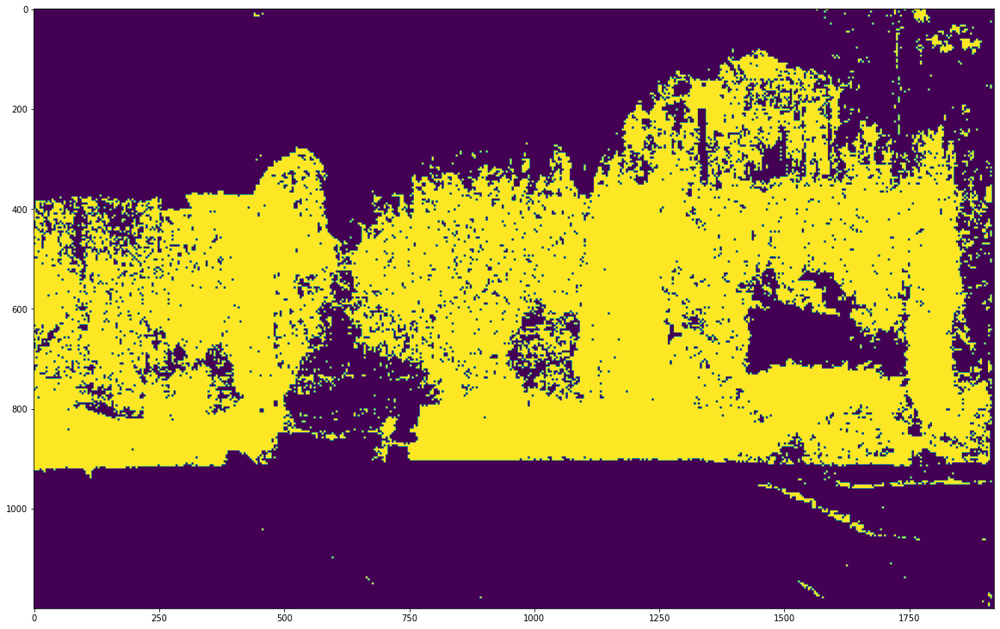

In [ ]:
plt.figure(figsize=(20, 20))
plt.imshow(scaled_tiles)

## Multispectral

In [ ]:
catboost_train_data_m = X_m_train.reshape((X_m_train.shape[0], -1))
catboost_test_data_m = X_m_test.reshape((X_m_test.shape[0], -1))

In [ ]:
from catboost import CatBoostClassifier

cat_model_m = CatBoostClassifier(#iterations=100,
                                 learning_rate=0.1,
                                 random_seed=63,
                                 custom_loss=['AUC', 'Accuracy'],
                                 #loss_function="binary_crossentropy",
                                 use_best_model=True,
                                 task_type="GPU",
                                 devices='0:1')

cat_model_m.fit(catboost_train_data_m,
          y_m_train,
          eval_set=(catboost_test_data_m, y_m_test),
          verbose=True)

0:	learn: 0.5553250	test: 0.5556701	best: 0.5556701 (0)	total: 17.7ms	remaining: 17.7s
1:	learn: 0.4631307	test: 0.4634707	best: 0.4634707 (1)	total: 34.1ms	remaining: 17s
2:	learn: 0.3977392	test: 0.3983231	best: 0.3983231 (2)	total: 50.5ms	remaining: 16.8s
3:	learn: 0.3580319	test: 0.3588414	best: 0.3588414 (3)	total: 66.6ms	remaining: 16.6s
4:	learn: 0.3283303	test: 0.3294186	best: 0.3294186 (4)	total: 83ms	remaining: 16.5s
5:	learn: 0.3085427	test: 0.3096097	best: 0.3096097 (5)	total: 99.3ms	remaining: 16.4s
6:	learn: 0.2925351	test: 0.2936366	best: 0.2936366 (6)	total: 116ms	remaining: 16.4s
7:	learn: 0.2801450	test: 0.2813329	best: 0.2813329 (7)	total: 136ms	remaining: 16.9s
8:	learn: 0.2703066	test: 0.2714553	best: 0.2714553 (8)	total: 152ms	remaining: 16.8s
9:	learn: 0.2625709	test: 0.2637463	best: 0.2637463 (9)	total: 168ms	remaining: 16.6s
10:	learn: 0.2564238	test: 0.2578051	best: 0.2578051 (10)	total: 183ms	remaining: 16.5s
11:	learn: 0.2514615	test: 0.2527929	best: 0.25279

### Accuracy

In [ ]:
cat_model_m.score(catboost_test_data_m, y_m_test)

0.927544934149954

### Visual test

In [ ]:
multi_cube = np.load(path.join(root_dir, 'consolidated', 'multi', 'multi_cube.npy'))

In [ ]:
multi_cube.shape

(1150, 1770, 5)

In [ ]:
def process_image_catboost_multi(model, image, tile_size):
  img_h, img_w, _ = image.shape

  tiles_num_x = img_w // tile_size
  tiles_num_y = img_h // tile_size

  tiles = []
  for i in range(tiles_num_x):
    for j in range(tiles_num_y):
      x0 = i * tile_size
      y0 = j * tile_size

      tiles.append(image[y0:y0 + tile_size, x0:x0 + tile_size])
  
  tiles = np.array(tiles)
  print(tiles.shape)
  tiles = tiles.reshape((len(tiles), -1))
  pred = model.predict(tiles)

  return pred.reshape((tiles_num_x, tiles_num_y)).T

In [ ]:
predicted_tiles = process_image_catboost_multi(cat_model_m, multi_cube, TILE_SIZE)

(126854, 4, 4, 5)


In [ ]:
predicted_tiles.shape

(287, 442)

In [ ]:
scaled_tiles = np.kron(predicted_tiles, np.ones((TILE_SIZE, TILE_SIZE)))

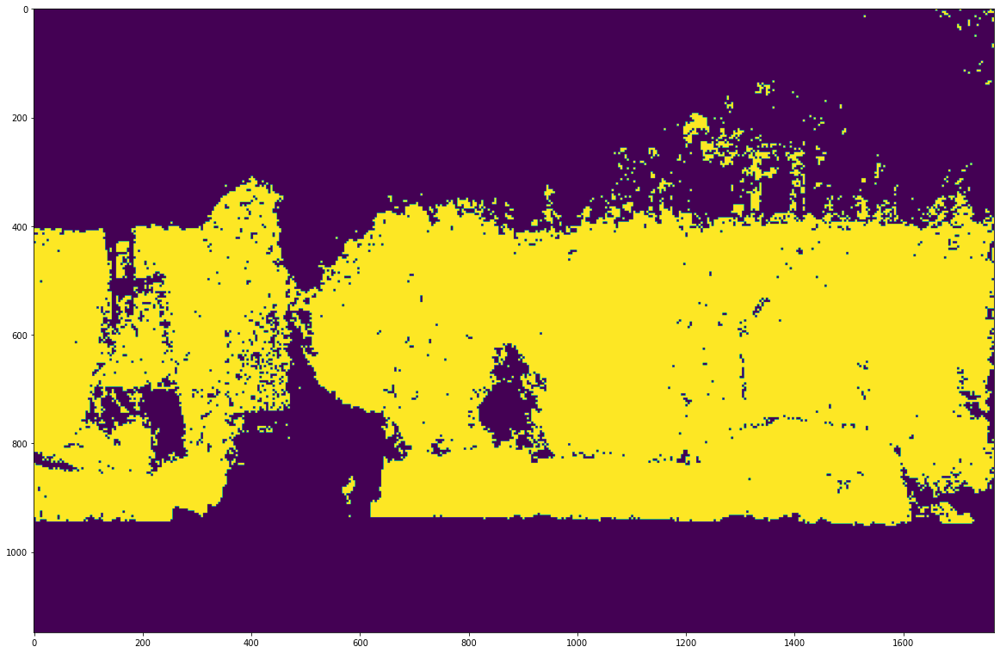

In [ ]:
plt.figure(figsize=(20, 20))
plt.imshow(scaled_tiles)

##Save model

In [ ]:
cat_model_m.save_model(path.join(root_dir, 'models', 'subtile_selector'))

# CNN

In [ ]:
batch_size = 64
epochs = 20
input_shape = X_c_train[0].shape

In [ ]:
def baseline_model():
    model = Sequential()
    model.add(Conv2D(32, (2, 2), padding='same', activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2), strides=(1, 1)))
    model.add(Dropout(0.25))

    model.add(Conv2D(32, (2, 2), padding='same', activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))

    model.add(Flatten())
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))

    return model

In [ ]:
logdir = path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

## Data augmentation

In [ ]:
datagen = ImageDataGenerator(horizontal_flip=True, vertical_flip=True)

In [ ]:
aug_c = datagen.flow(X_c_train, y_c_train, batch_size=batch_size, shuffle=False)

In [ ]:
# пропускаем один канал (470 нм), потому что ImageDataGenerator принимает на вход изображения максимум с 4 слоями
aug_m = datagen.flow(X_m_train[:,:,:,1:], y_m_train, batch_size=batch_size, shuffle=False)

## Color

### Normal

In [ ]:
model_с = baseline_model()
model_с.compile(loss=BinaryCrossentropy(), optimizer='adam', metrics=['binary_accuracy'])

In [ ]:
history_c = model_с.fit(X_c_train, y_c_train,
                    batch_size=batch_size,
                    epochs=epochs,
                    verbose=1,
                    validation_data=(X_c_test, y_c_test),
                    callbacks=[tensorboard_callback, EarlyStopping(monitor='val_binary_accuracy', patience=3)])

Epoch 1/20
1771/1771 [==============================] - 10s 4ms/step - loss: 0.4070 - binary_accuracy: 0.7862 - val_loss: 0.3271 - val_binary_accuracy: 0.8534
Epoch 2/20
1771/1771 [==============================] - 6s 3ms/step - loss: 0.3357 - binary_accuracy: 0.8498 - val_loss: 0.3135 - val_binary_accuracy: 0.8542
Epoch 3/20
1771/1771 [==============================] - 6s 3ms/step - loss: 0.3230 - binary_accuracy: 0.8541 - val_loss: 0.3075 - val_binary_accuracy: 0.8563
Epoch 4/20
1771/1771 [==============================] - 6s 3ms/step - loss: 0.3162 - binary_accuracy: 0.8572 - val_loss: 0.3097 - val_binary_accuracy: 0.8574
Epoch 5/20
1771/1771 [==============================] - 6s 3ms/step - loss: 0.3104 - binary_accuracy: 0.8574 - val_loss: 0.2989 - val_binary_accuracy: 0.8627
Epoch 6/20
1771/1771 [==============================] - 6s 3ms/step - loss: 0.3090 - binary_accuracy: 0.8570 - val_loss: 0.2991 - val_binary_accuracy: 0.8646
Epoch 7/20
1771/1771 [=============================

### Aug

In [ ]:
model_с_aug = baseline_model()
model_с_aug.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
history_c_aug = model_с_aug.fit(aug_c,
                                steps_per_epoch=len(X_c_train) // batch_size,
                                epochs=epochs,
                                verbose=1,
                                validation_data=(X_c_test, y_c_test),
                                callbacks=[tensorboard_callback, EarlyStopping(monitor='val_accuracy', patience=3)])

Epoch 1/20
1770/1770 [==============================] - 9s 5ms/step - loss: 0.4140 - accuracy: 0.7780 - val_loss: 0.3254 - val_accuracy: 0.8562
Epoch 2/20
1770/1770 [==============================] - 8s 4ms/step - loss: 0.3323 - accuracy: 0.8507 - val_loss: 0.3109 - val_accuracy: 0.8588
Epoch 3/20
1770/1770 [==============================] - 8s 4ms/step - loss: 0.3226 - accuracy: 0.8546 - val_loss: 0.3047 - val_accuracy: 0.8610
Epoch 4/20
1770/1770 [==============================] - 8s 4ms/step - loss: 0.3147 - accuracy: 0.8568 - val_loss: 0.3191 - val_accuracy: 0.8567
Epoch 5/20
1770/1770 [==============================] - 7s 4ms/step - loss: 0.3082 - accuracy: 0.8583 - val_loss: 0.3059 - val_accuracy: 0.8600
Epoch 6/20
1770/1770 [==============================] - 7s 4ms/step - loss: 0.3078 - accuracy: 0.8584 - val_loss: 0.2957 - val_accuracy: 0.8645
Epoch 7/20
1770/1770 [==============================] - 7s 4ms/step - loss: 0.3062 - accuracy: 0.8601 - val_loss: 0.2950 - val_accuracy:

### Test


In [ ]:
def process_image(model, image, tile_size):
  img_h, img_w, _ = image.shape

  tiles_num_x = img_w // tile_size
  tiles_num_y = img_h // tile_size

  tiles = []
  for i in range(tiles_num_x):
    for j in range(tiles_num_y):
      x0 = i * tile_size
      y0 = j * tile_size

      tiles.append(image[y0:y0 + tile_size, x0:x0 + tile_size])
  
  tiles = np.array(tiles)
  pred = model.predict(tiles)

  return pred.reshape((tiles_num_x, tiles_num_y)).T

In [ ]:
img = plt.imread(path.join(root_dir, 'consolidated', 'color', 'rgb.png'))

In [ ]:
predicted_tiles = process_image(model_с, img, TILE_SIZE)

In [ ]:
predicted_tiles.shape

(300, 480)

In [ ]:
scaled_tiles = np.kron(predicted_tiles, np.ones((TILE_SIZE, TILE_SIZE)))

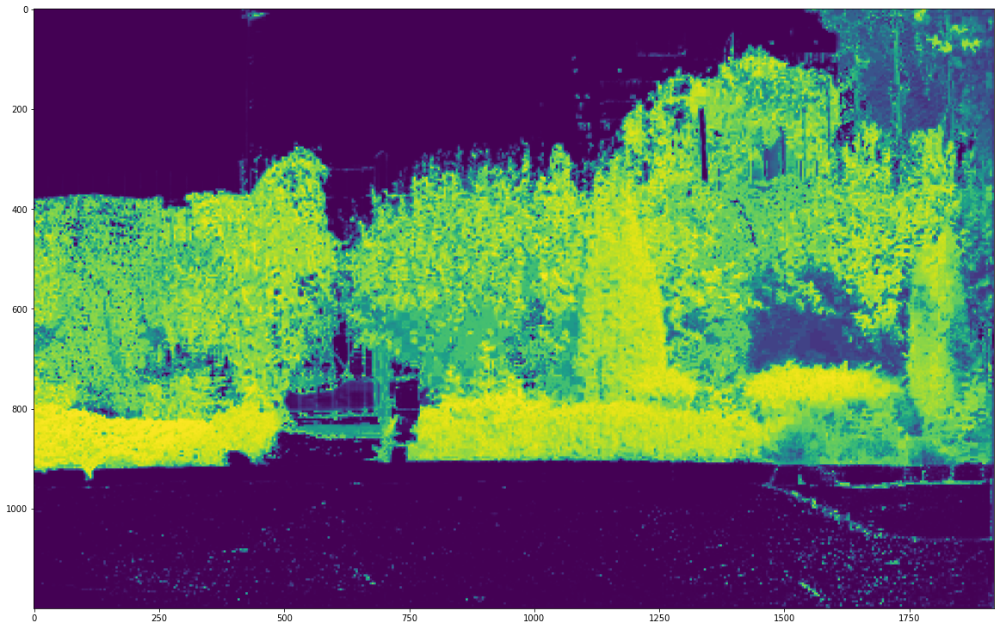

In [ ]:
plt.figure(figsize=(20, 20))
plt.imshow(scaled_tiles)

In [ ]:
scaled_tiles.mean()

0.3864201766397068

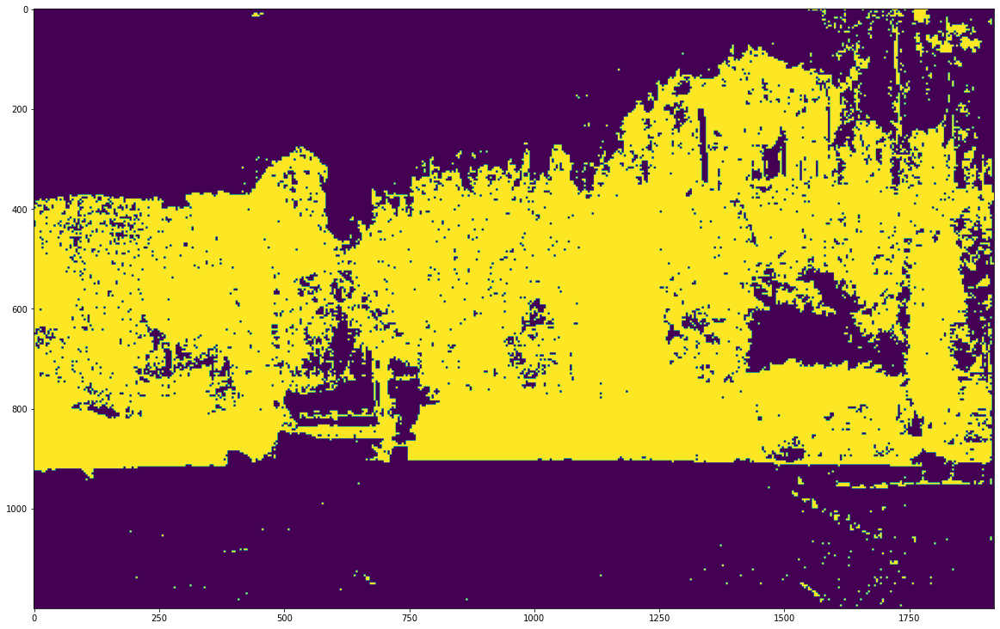

In [ ]:
plt.figure(figsize=(20, 20))
plt.imshow(scaled_tiles > 0.5)

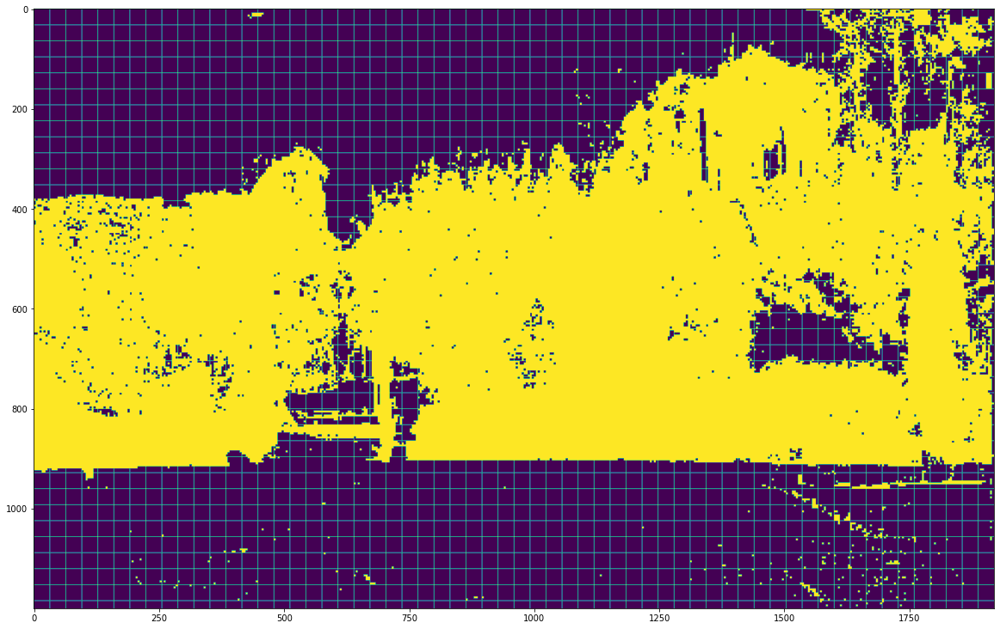

In [ ]:
grid_color = 1
t = 32
scaled_tiles[:,::t] = grid_color
scaled_tiles[::t,:] = grid_color
plt.figure(figsize=(20, 20))
plt.imshow(scaled_tiles > 0.35)

## Multispectral

In [ ]:
# TODO: написать свой ImageGenerator, который будет работать с изображениями произвольного размера
# https://github.com/keras-team/keras-preprocessing/blob/master/keras_preprocessing/image/image_data_generator.py

### Normal

In [ ]:
model_m = baseline_model()
model_m.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
history_m = model_m.fit(X_m_train, y_m_train,
                        batch_size=batch_size,
                        epochs=epochs,
                        verbose=1,
                        validation_data=(X_m_test, y_m_test),
                        callbacks=[tensorboard_callback])

Epoch 1/20
1562/1562 [==============================] - 6s 4ms/step - loss: 0.2939 - accuracy: 0.8743 - val_loss: 0.2307 - val_accuracy: 0.9070
Epoch 2/20
1562/1562 [==============================] - 5s 3ms/step - loss: 0.2373 - accuracy: 0.9040 - val_loss: 0.2259 - val_accuracy: 0.9085
Epoch 3/20
1562/1562 [==============================] - 5s 3ms/step - loss: 0.2323 - accuracy: 0.9061 - val_loss: 0.2137 - val_accuracy: 0.9151
Epoch 4/20
1562/1562 [==============================] - 5s 3ms/step - loss: 0.2239 - accuracy: 0.9116 - val_loss: 0.2166 - val_accuracy: 0.9155
Epoch 5/20
1562/1562 [==============================] - 5s 3ms/step - loss: 0.2171 - accuracy: 0.9142 - val_loss: 0.2129 - val_accuracy: 0.9165
Epoch 6/20
1562/1562 [==============================] - 5s 3ms/step - loss: 0.2147 - accuracy: 0.9152 - val_loss: 0.2057 - val_accuracy: 0.9171
Epoch 7/20
1562/1562 [==============================] - 5s 3ms/step - loss: 0.2117 - accuracy: 0.9160 - val_loss: 0.2018 - val_accuracy:

### Aug

In [ ]:
model_m_aug = baseline_model()
model_m_aug.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
history_m_aug = model_m_aug.fit(aug_m,
                                steps_per_epoch=len(X_m_train) // batch_size,
                                epochs=epochs,
                                verbose=1,
                                validation_data=(X_m_test[:,:,:,1:], y_m_test),
                                callbacks=[tensorboard_callback])

Epoch 1/20
1561/1561 [==============================] - 8s 5ms/step - loss: 0.3049 - accuracy: 0.8727 - val_loss: 0.2399 - val_accuracy: 0.9089
Epoch 2/20
1561/1561 [==============================] - 7s 4ms/step - loss: 0.2434 - accuracy: 0.9033 - val_loss: 0.2276 - val_accuracy: 0.9111
Epoch 3/20
1561/1561 [==============================] - 6s 4ms/step - loss: 0.2340 - accuracy: 0.9068 - val_loss: 0.2241 - val_accuracy: 0.9127
Epoch 4/20
1561/1561 [==============================] - 7s 4ms/step - loss: 0.2305 - accuracy: 0.9083 - val_loss: 0.2226 - val_accuracy: 0.9112
Epoch 5/20
1561/1561 [==============================] - 7s 4ms/step - loss: 0.2279 - accuracy: 0.9101 - val_loss: 0.2171 - val_accuracy: 0.9155
Epoch 6/20
1561/1561 [==============================] - 7s 4ms/step - loss: 0.2249 - accuracy: 0.9112 - val_loss: 0.2140 - val_accuracy: 0.9160
Epoch 7/20
1561/1561 [==============================] - 7s 4ms/step - loss: 0.2207 - accuracy: 0.9141 - val_loss: 0.2152 - val_accuracy:

### Test

In [ ]:
multi_cube = np.load(path.join(root_dir, 'consolidated', 'multi', 'multi_cube.npy'))

In [ ]:
multi_cube.shape

(1150, 1770, 5)

In [ ]:
def process_image_multi(model, image, tile_size):
  img_h, img_w, _ = image.shape

  tiles_num_x = img_w // tile_size
  tiles_num_y = img_h // tile_size

  tiles = []
  for i in range(tiles_num_x):
    for j in range(tiles_num_y):
      x0 = i * tile_size
      y0 = j * tile_size

      tiles.append(image[y0:y0 + tile_size, x0:x0 + tile_size])
  
  tiles = np.array(tiles)
  pred = model.predict(tiles)

  return pred.reshape((tiles_num_x, tiles_num_y)).T

In [ ]:
predicted_tiles = process_image_multi(model_m, multi_cube, TILE_SIZE)

In [ ]:
predicted_tiles.shape

(287, 442)

In [ ]:
scaled_tiles = np.kron(predicted_tiles, np.ones((TILE_SIZE, TILE_SIZE)))

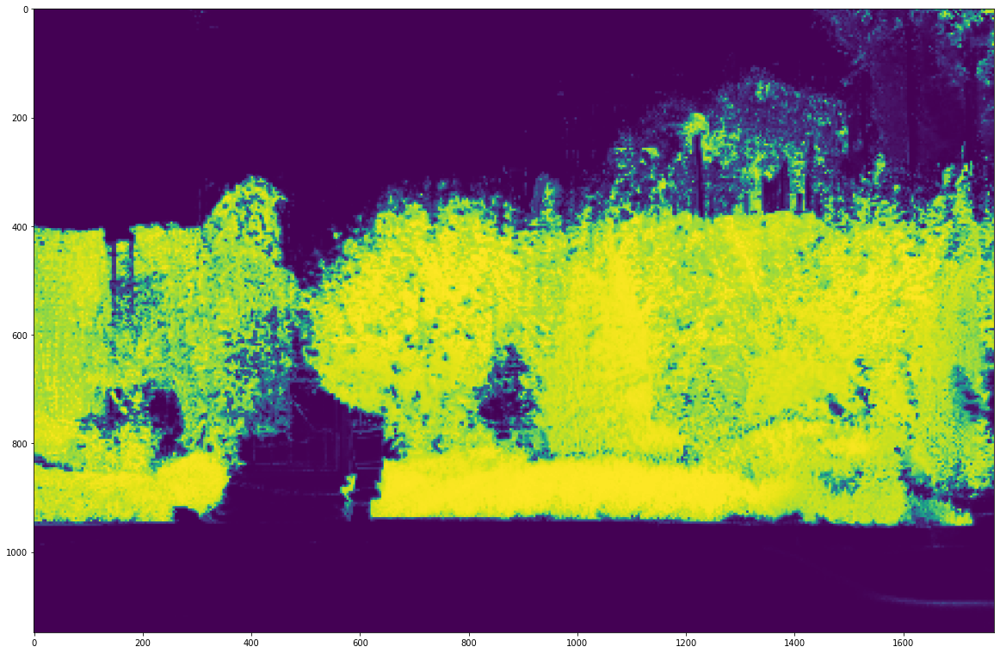

In [ ]:
plt.figure(figsize=(20, 20))
plt.imshow(scaled_tiles)

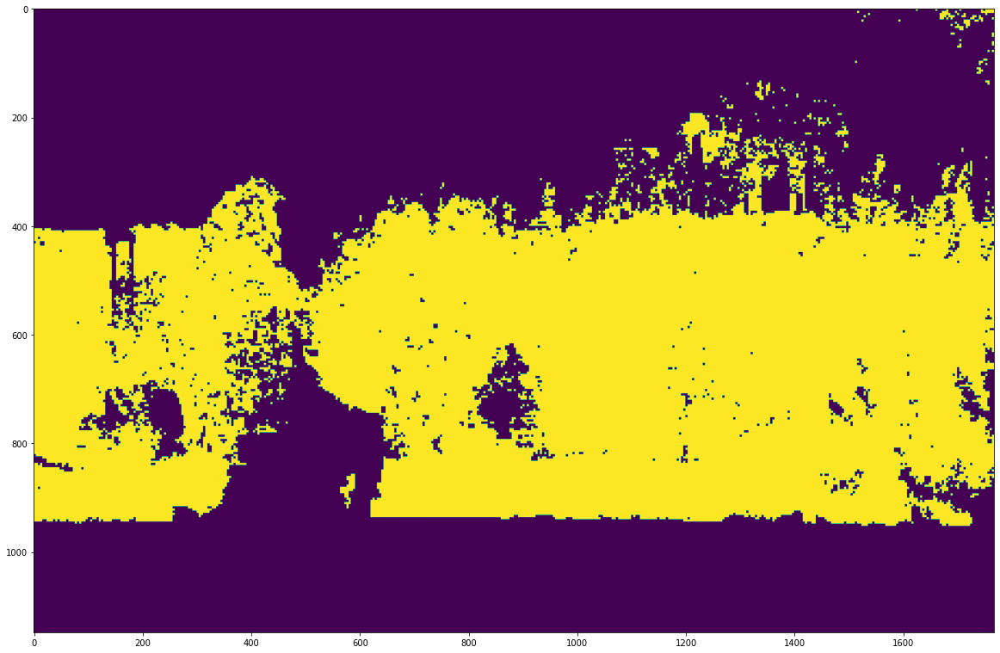

In [ ]:
plt.figure(figsize=(20, 20))
plt.imshow(scaled_tiles > 0.5)

# Tensorboard

In [ ]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 4286), started 0:38:54 ago. (Use '!kill 4286' to kill it.)

<IPython.core.display.Javascript object>

# Сохранение моделей

In [ ]:
def save_model(model, model_name):
  model.save(path.join(root_dir, 'tiles_data_foliage_other', 'models', model_name))

In [ ]:
save_model(model_с, 'model_c_{}_baseline'.format(TILE_SIZE))

INFO:tensorflow:Assets written to: /gdrive/My Drive/diploma/tiles_data_foliage_other/models/model_c_4_baseline/assets


# Собираем все вместе

In [ ]:
import tensorflow as tf
import tensorflow.math as tfm
import math

In [ ]:
# pads image to make it a multiple of tile size
def pad_image_to_tile_multiple(image, tile_size, padding="CONSTANT"):
  imagesize = tf.shape(image)[0:2]
  padding_ = tf.cast(tfm.ceil(imagesize / tile_size), tf.int32) * tile_size - imagesize
  return tf.pad(image, [[0, padding_[0]], [0, padding_[1]], [0, 0]], padding)

# cuts image into tiles
def split_image(image, tile_size):
  image_shape = tf.shape(image)
  tile_rows = tf.reshape(image, [image_shape[0], -1, tile_size[1], image_shape[2]])
  serial_tiles = tf.transpose(tile_rows, [1, 0, 2, 3])
  return tf.reshape(serial_tiles, [-1, tile_size[1], tile_size[0], image_shape[2]])

# make tiles from image
def make_tiles(padded_img, tile_shape):
  # channels last format
  tiles = split_image(padded_img, tile_shape)

  rows, cols, channels_num = padded_img.shape

  return (tiles, rows // tile_shape[0], cols // tile_shape[1])

In [ ]:
# assembles image from tiles
def unsplit_image(tiles, image_shape):
  tile_width = tf.shape(tiles)[1]
  serialized_tiles = tf.reshape(tiles, [-1, image_shape[0], tile_width, image_shape[2]])
  rowwise_tiles = tf.transpose(serialized_tiles, [1, 0, 2, 3])
  return tf.reshape(rowwise_tiles, [image_shape[0], image_shape[1], image_shape[2]])

In [ ]:
# classifies subtiles with given model
def classify_subtiles(subtiles, selector_model, subtile_shape):
  tiles_np = tf.reshape(subtiles, (tiles.shape[0], -1)).numpy()
  return selector_model.predict(tiles_np)

In [ ]:
def pick_tiles(tile_shape, subtiles_nums, subtile_shape, threshold=0.8):
  scaled_prediction = np.expand_dims(np.kron(pred.reshape(subtiles_nums).T, np.ones(subtile_shape)), axis=-1)
  padded_scaled_prediction = pad_image_to_tile_multiple(scaled_prediction, tile_shape)

  pixels_count = tile_shape[0] * tile_shape[1]
  prediction_tiles = np.squeeze(split_image(padded_scaled_prediction, tile_shape))
  tiles_rank = tf.math.reduce_sum( tf.math.reduce_sum(prediction_tiles, 1), 1) / pixels_count

  tiles_mask = tiles_rank > threshold

  padded_w, padded_h, _ = padded_scaled_prediction.shape
  padded_w //= tile_shape[0]
  padded_h //= tile_shape[1]

  return (tiles_mask, padded_h, padded_w)

In [ ]:
# channels last
def process_images(multispectral_images):
  spectral_cube = [img[:,:,0] for img in multispectral_images]

  tile_dims = [32, 32]
  subtile_dims = [4, 4]

  padded_cube = pad_image_to_tile_multiple(spectral_cube, subtile_dims)
  # subtile, number of subtile rows, cols
  (subtiles, st_rows, st_cols) = make_tiles(padded_cube, subtile_dims)
  (tiles, t_rows, t_cols) = make_tiles(padded_cube, subtile_dims)

  pred = classify_subtiles(tiles, cat_model_m, subtile_dims)

  (t, h, w) = pick_tiles(tile_dims, (st_cols, st_rows), subtile_dims, 0.5)
  selected_tiles_mask = t.reshape(h, w).T

In [ ]:
tile_dims = [32, 32]
subtile_dims = [4, 4]

In [ ]:
multi_cube.shape

(1150, 1770, 5)

In [ ]:
padded_cube = pad_image_to_tile_multiple(multi_cube, subtile_dims)

In [ ]:
padded_cube.shape

TensorShape([1152, 1772, 5])

In [ ]:
(subtiles, st_rows, st_cols) = make_tiles(padded_cube, subtile_dims)

In [ ]:
print((subtiles.shape, st_rows, st_cols))

(TensorShape([127584, 4, 4, 5]), 288, 443)


In [ ]:
(tiles, t_rows, t_cols) = make_tiles(padded_cube, subtile_dims)

In [ ]:
tiles_np = tf.reshape(subtiles, (tiles.shape[0], -1)).numpy()

In [ ]:
pred = cat_model_m.predict(tiles_np)

In [ ]:
tiles_np[0]

array([0.827451  , 0.6627451 , 0.18039216, 0.12941177, 0.03137255,
       0.827451  , 0.6627451 , 0.18039216, 0.12941177, 0.03137255,
       0.827451  , 0.6666667 , 0.18039216, 0.12941177, 0.03137255,
       0.83137256, 0.6666667 , 0.18431373, 0.13333334, 0.03137255,
       0.827451  , 0.6627451 , 0.18039216, 0.12941177, 0.03137255,
       0.827451  , 0.6666667 , 0.18039216, 0.12941177, 0.03137255,
       0.83137256, 0.6666667 , 0.18039216, 0.12941177, 0.03137255,
       0.83137256, 0.6666667 , 0.18431373, 0.13333334, 0.03137255,
       0.827451  , 0.6666667 , 0.18039216, 0.13725491, 0.03137255,
       0.83137256, 0.6666667 , 0.18039216, 0.13725491, 0.03137255,
       0.83137256, 0.6666667 , 0.18039216, 0.13725491, 0.03137255,
       0.83137256, 0.67058825, 0.18431373, 0.14117648, 0.03137255,
       0.83137256, 0.6666667 , 0.18039216, 0.13725491, 0.03137255,
       0.83137256, 0.6666667 , 0.18039216, 0.13725491, 0.03137255,
       0.83137256, 0.67058825, 0.18039216, 0.13725491, 0.03137

In [ ]:
pred.sum()

53381.0

In [ ]:
(t, h, w) = pick_tiles(tile_dims, (st_cols, st_rows), subtile_dims, 0.5)

In [ ]:
t = t.numpy()

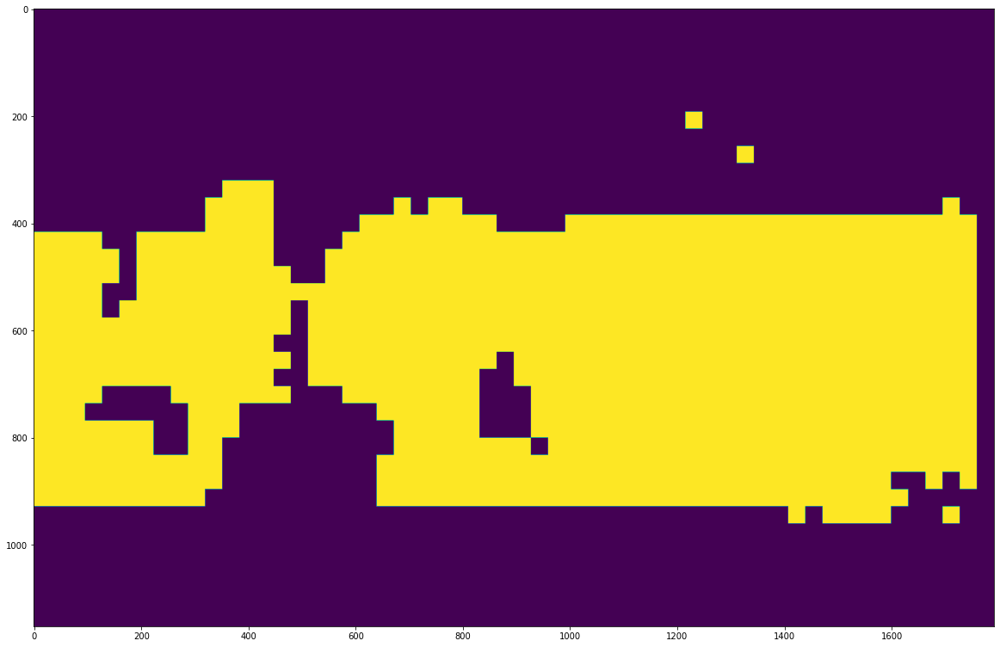

In [ ]:
plt.figure(figsize=(20, 20))
plt.imshow(np.kron(t.reshape(h, w).T, np.ones(tile_dims)))

In [ ]:
!pip3 freeze > /tmp/requirements.txt

In [ ]:
np.stack([[[1, 2],[2, 3],[3, 4]], [[1, 2],[2, 3],[3, 4]], [[1, 2],[2, 3],[3, 4]]], axis=-1)

array([[[1, 1, 1],
        [2, 2, 2]],

       [[2, 2, 2],
        [3, 3, 3]],

       [[3, 3, 3],
        [4, 4, 4]]])